<center><h1>Graph project: Epidemic spreading</h1></center>

<center><h4>ENSEEIHT SN, notebook written by Bastien Vieuble</h4></center>

<div style="width:75%;margin:0 auto;">
    
## Introduction
<a id='intro'></a>
    
<p style="text-align:justify;"> As you know, a new epidemic appeared in the world. COVID-19 jeopardizes people and changes our habits. It is easy to realise that knowing how illnesses spread is vital to our own protection. How can we predict whether a disease will cause an epidemic, how many people it will infect, which people it will infect, and whether or not it is dangerous to society as a whole ? Also, how can we determine which techniques to use in fighting an epidemic once it begins ? One way to answer all of these questions is through <strong>mathematical modeling</strong>. </p>

<p style="text-align:justify;"> In this work you will review different epidemic modelings relying all on the representation by graphs of a human network called a <strong>contact network</strong>. A vertex in a contact network represents an individual and an edge between two vertices represents a contact between two individuals. The disease only spread from individual to individual if they are in contact, so through the edges. This representation is actually really common in research, and a lot of state-of-the-art modeling are built over it. From these different models you will be asked to draw conclusions from experiments on varying contact networks.</p>

<p style="text-align:justify;"> For readability and ease of use, this project will be carried on a <strong>Jupyter Notebook</strong>, hence code and question answering have to be written in this unique file. As for question answering, you can use <strong>markdown cells</strong> (Cellule > Type de cellule > Markdown) in which you can type in markdown (tutorial: <a>https://www.datacamp.com/tutorial/markdown-in-jupyter-notebook</a>).</p>

<p style="text-align:justify;">  This is a <strong>DUO</strong> project and no group of one person will be accepted. The duo has to be composed of same TD group students, if the number of students in the TD group is odd we will accept one group composed of three students. It will be coded in Julia using the LightGraphs package. <strong>IMPORTANT POINTS:</strong> 
    
- If the code does not provide good results, its readability as well as its comments are essential for the corrector to potentially find some notation points.
- The specifications of the functions have to be strictly respected.
- Do not neglect written questions, they stand for an important part of the notation, you are not only evaluated on the coding. Also, even when a written question does not ask you directly to code or provide results from code, supporting your arguments when possible with a runable example is very welcome and sometimes even expected.
- Any pertinent initiatives and additional efforts bringing contents and thoughts out of the question scope may result in bonus points.
</p>
    
<p style="text-align:justify;"> Deliverable: You will deliver your work on moodle the <strong style="font-size:1.3em">5th of April 2023</strong> before 23:59 in a <strong style="font-size:1.3em">.tar</strong> containing the notebook with your codes and your written answers, and the different graph figures in .png you will generate.

LightGraphs github: <a>https://github.com/sbromberger/LightGraphs.jl</a>

<div style="width:75%;margin:0 auto;">

## Environment and packages installation
<a id='env'></a>
    

<p style="text-align:justify;"> <strong>IMPORTANT</strong>: For evaluation, coding questions have to run with no additional packages ! However if you want to use another package to go further in your answer and add bonus contents, take care of separating the cells.</p>

In [1]:
# TO RUN ONLY ONCE
using Pkg
Pkg.activate(".") # Path to Manifest.toml and Project.toml
Pkg.resolve()
# Pkg.add("...") pour ajouter un package

  Activating project at `~/Desktop/ModIA/S8/Theorie_des_graphes`
┌ Warning: The active manifest file at `/Users/mussard/Desktop/ModIA/S8/Theorie_des_graphes/Manifest.toml` has an old format that is being maintained.
│ To update to the new format, which is supported by Julia versions ≥ 1.6.2, run `Pkg.upgrade_manifest()` which will upgrade the format without re-resolving.
│ To then record the julia version re-resolve with `Pkg.resolve()` and if there are resolve conflicts consider `Pkg.update()`.
└ @ Pkg.Types /Users/julia/.julia/scratchspaces/a66863c6-20e8-4ff4-8a62-49f30b1f605e/agent-cache/default-macmini-x64-6.0/build/default-macmini-x64-6-0/julialang/julia-release-1-dot-8/usr/share/julia/stdlib/v1.8/Pkg/src/manifest.jl:287
  No Changes to `~/Desktop/ModIA/S8/Theorie_des_graphes/Project.toml`
  No Changes to `~/Desktop/ModIA/S8/Theorie_des_graphes/Manifest.toml`


In [1]:
using LightGraphs
using GraphPlot
using Colors
using Plots
using JLD2

<div style="width:75%;margin:0 auto;">

## Part 1 - SIS model
<a id='part1'></a>

<p style="text-align:justify;">SIS is a compartmental model, i.e. a model where the population is divided into subgroups that represent the disease status of its members. SIS stands for Susceptible $\rightarrow$ Infected $\rightarrow$ Susceptible where the susceptible group contains those who remain susceptible to the infection, and the infected group consists of those who not only have the disease but are also in the contagious period of the disease.</p>
    
<p style="text-align:justify;"> Combine with a contact network approach, this model can capture contact patterns (family, company, friends). Each vertex represents an individual in the host population, and contacts between two individuals are represented by an edge that connects the two. The probability of transmitting the disease from an infected to a susceptible individual along one of these edges or contacts is $\beta$ (=<strong>infection rate</strong>). The probability to cure is $\alpha$ (= <strong>curing rate</strong>). </p>

    
<p style="text-align:justify;">In order for a disease to begin spreading through a network, the disease must be introduced into the population, either through infecting a proportion of the population or through infecting one individual. As time moves forward, the disease will spread away from those initially infected, and two things may occur <strong>simultaneously</strong> at each time step $t$. First, each infected individual will spread disease to each of its contacts with a probability $\beta$. Secondly, each infectious individual will recover at a rate, $\alpha$ , at which point the individual will then no longer infect any of its contacts. After the disease has run its course, we can determine how the disease affected the network by calculating various quantities that help us better understand the outbreak.
</p>

<br>
    
<p style="font-size:0.9em">P. Van Mieghem, J. Omic, R. E. Kooij, <em>“Virus Spread in Networks”</em>,
IEEE/ACM Transaction on Networking (2009)<p>


<!---
<div style="background-color:rgba(0, 0, 0, 0.0470588); padding:10px 0;font-family:monospace;">
<font size = 4.5px><b>Algorithm 1:</b> Girvan Newman</font><br>
    <div style="margin-left:50px;border-left:2px solid black;padding-left:10px;">
    <b> WHILE </b> there are still edges<b> OR </b> desired nb of communities unreached <b>DO</b>
        <div style="margin-left:50px;border-left:2px solid black;padding-left:10px;">
        Calculate betweeness of all edges <br>
        Remove the edge with the highest betweeness <br>
        Calculate the number of strongly connected components
        </div>
    <b> END WHILE </b>   
    </div>
</div>
--->

<div style="width:75%;margin:0 auto;">

### 1.1 Contact networks sample

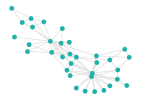

In [2]:
"""karat7: A graph representing the karate club of N7 and the connections between the persons in this club.
There are 34 people in this network. It is actually inspired by one of the most famous problem in graph
theory: the Zachary's karate club.
"""
karat7 = smallgraph(:karate)
nodecolor = [colorant"lightseagreen"]
#draw(PNG("karat7.png", 100cm, 100cm), gplot(karat7,nodefillc=nodecolor)) # save the png showing graph karat7
gplot(karat7,nodefillc=nodecolor)

<strong>Warning!</strong> due to a bug with a library, to see the colors of graphs with too much nodes like n7_2A and toulouse_neigh, you will have to add arguments nodestrokec and nodestrokelw to function <code>gplot</code> which are vectors of same size as nodefillc:

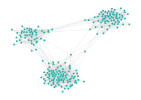

In [3]:
"""n7_2A: A graph representing the second year students at N7. Each department (SN, MF2E, 3EA) form a 
community where connections are denser, connections between department are rarer.
"""
c=[[10,0,0] [0.1,10,0] [0.1,0.1,10]]
n=[100,70,50]
n7_2A = stochastic_block_model(c,n)
nodecolor = [colorant"lightseagreen"]
nodefillc=nodecolor
gplot(n7_2A,nodefillc=nodecolor, nodestrokec = nodefillc, nodestrokelw = zeros(Float32, nv(n7_2A)))

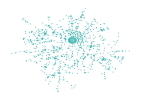

In [4]:
"""toulouse_neigh: A graph representing a neighborhood composed of 1000 people in Toulouse.
"""
toulouse_neigh = barabasi_albert(1000, 1)
nodecolor = [colorant"lightseagreen"]
nodefillc=nodecolor
gplot(toulouse_neigh,nodefillc=nodecolor, nodestrokec = nodefillc, nodestrokelw = zeros(Float32, nv(toulouse_neigh)))

<div style="width:75%;margin:0 auto;">
  
### 1.2 Introduce the infection
    
<p style="text-align:justify;">We denote by <code>state</code> a vector containing the disease status of each vertex where Susceptible=0 and Infected=1. Then <code>state</code> is an <code>Array{Int32,1}</code> of length the number of vertices. This array in addition to a graph (represented internally by an adjacency matrix or an adjacency list) will be the data structure of our model.</p>
    
<span style="font-size:0.9em">In <code>Array{Int32,1}</code>, <code>Int32</code> refers to the kind of data in the array, here 32 bits integers, <code>1</code> refers to the dimension of the array, here we have a 1-dimensional structure so a vector.</span>

<div style="width:75%;margin:0 auto;">

<strong style="color:cornflowerblue">Question 1 (code):</strong> For each graph in the graph sample (<code>karat7</code>, <code>n7_2A</code>, <code>toulouse_neigh</code>) initialize the state array by assigning each vertex to susceptible and add randomly one or numerous infected people. Plot the graph using <code>gplot</code> and <code>draw</code>, infected should appear in a different color (<code>colorant"orange"</code>).
    
Gplot GitHub: https://github.com/JuliaGraphs/GraphPlot.jl
    
Gplot examples: https://juliagraphs.org/GraphPlot.jl/

Fonction permettant de construire le vecteur state 

In [5]:
function generate_infected(net,nbinf)
    """ Génération de la matrice state contenant l'information sur les personnes infectés 
    => 0 = personne non infectée, 1=> personne infectée
    
    PARAMS
       net (LightGraph): graph representing the contact network
       
       nbinf (Int64): Nombre de personnes infectées
    RETURNS
        (Array{Int32,1}): disease status of each vertex
    """  
    indices_infectes = rand(1:nv(net),nbinf) # On tire aléatoirement nbinf indices entre 1 et le nb de sommets => Personnes infectées 
    while allunique(indices_infectes)==false #On regarde si plusieurs valeurs sont égales
        indices_infectes = rand(1:nv(net),nbinf) #On regénère alors nbinf indices
    end
    state = zeros(Int32,nv(net))
    state[indices_infectes].=1 # Vecteur 0=> Personne non inféctée, 1=> Personne inféctée
    return state
end

generate_infected (generic function with 1 method)

In [6]:
function generate_graph(net, state)
    """ Affichage du graphe
    
    PARAMS
       net (LightGraph): graph representing the contact network
       
       nbinf (Int64): Nombre de personnes infectées
    RETURNS
        gplot: plot of the graph
    """  
    #On colorie le graph en orange pour les personnes infectées
    nodecolor = [colorant"lightseagreen", colorant"orange", colorant"purple", colorant"lightgreen"]
    nodefillc=nodecolor[state+ones(Int32, length(state))]
    if nv(net)>34
        gplot(net,nodefillc=nodefillc, nodestrokec=nodefillc, nodestrokelw=zeros(length(state)))
    else
        gplot(net,nodefillc=nodefillc, nodestrokec=nodefillc, nodestrokelw=zeros(length(state)), nodelabel = 1:nv(net))
    end
end

generate_graph (generic function with 1 method)

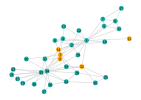

In [7]:
# Infect Karat7
nbinf=5
state_karat7= generate_infected(karat7,nbinf)
generate_graph(karat7, state_karat7)

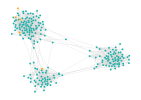

In [8]:
# Infect N7_2A
state_n7_2A= generate_infected(n7_2A,nbinf)
generate_graph(n7_2A, state_n7_2A)

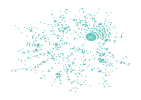

In [9]:
# Infect Toulouse_neigh
state_toulouse= generate_infected(toulouse_neigh,nbinf)
generate_graph(toulouse_neigh, state_toulouse)

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 2 (written):</strong> What do you think/predict about the influence of the initial number of infected people and their locations on the evolution of an SIS model epidemic ?

<br>
    
<div style="background-color:#E7F1D1"><strong>Answer:</strong></div>
    
    
        En considérant que le graphe est connexe, on peut dire que plus le nombre initial de personnes infectées est grand plus l'épidémie va se propager vite car chacun des infectés peut potentiellement contaminer ses voisins. De plus, la localisation des personnes va influencer sur la propagation de l'épidémie. En effet, en considérant là aussi que nous avons un graphe connexe, si on a des personnes qui sont localisés au bout d'un graphe et qui ont seulement quelques contacts avec d'autres personnes, l'épidémie se propagera moins vite.

<div style="width:75%;margin:0 auto;">
  
### 1.3 Spread the infection

<div style="width:75%;margin:0 auto;">
      
<strong style="color:cornflowerblue">Question 3 (code):</strong> Implement the <code>function SIS</code> (respect the header and the specifications). You can use <code>rand</code> to translate the probabilities. Test your algorithm on <code>karat7</code>, <code>n7_2A</code>, and <code>toulouse_neigh</code> with arbitrary $\beta$, $\alpha$, and $t$.
    
<span style="font-size:0.9em">The corrector should be able to write <code>new_state = SIS(net,state,beta,alpha,t)</code> with your code.</span>

In [10]:
function SIS(net,state,beta,alpha,t)
    """Take a contact network at a certain state and apply t time steps
    of an SIS model.
    
    PARAMS
       net (LightGraph): graph representing the contact network
       state (Array{Int32,1}): disease status of each vertex
       beta (Float64): infection rate
       alpha (Float64): curing rate
       t (Int32): number of time step
    
    RETURNS
        (Array{Int32,1}): The new state of the contact network after t time steps.
    """     
    state_c = copy(state)
    for time_step in 1:t
        old_state = copy(state_c) #On crée une copie de l'état à l'itération précédente pour ne pas infecter plusieurs fois une même personne
        for s in 1:length(state_c)
            if old_state[s] ==1 # La personne à l'itération précédente est infectée 
                voisins = neighbors(net, s) #On récupère les indices de ses voisins
                for n in 1:length(voisins) 
                    if old_state[voisins[n]]==0 #Si le voisin à l'itération précédente n'était pas infecté alors on peut l'infecter
                        if rand() <= beta #On le contamine avec la proba beta
                            state_c[voisins[n]]=1
                        end 
                    end 
                end 
                if rand() <= alpha #On guérit la personne avec la proba alpha
                    state_c[s] = 0 
                    
                end
            end 
        end 
    end
    return state_c
    
end 

SIS (generic function with 1 method)

1. Test pour une proba $\beta=1$, $\alpha=1$ => on sait que les voisins d'un infecté vont être automatiquement malade et à l'itération suivante les infectés de l'itération précédente guériront

Graphe initial au temps t=0

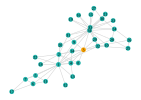

In [11]:
# Test on Karat7
nbinf=1
state_karat7 = generate_infected(karat7,nbinf)
generate_graph(karat7, state_karat7)

Graphe a t=1

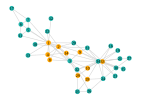

In [12]:
state_c = SIS(karat7,state_karat7,1,1,1) # Récupérer l'etat 
generate_graph(karat7, state_c)

2. Test pour $\beta=1$, $\alpha=0$ => Au bout d'un certain temps toutes les personnes devraient être inféctées

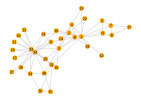

In [13]:
state_c = SIS(karat7,state_karat7,1,0,3) # Récupérer l'etat 
generate_graph(karat7, state_c)

3. Test pour $\beta=0$ et $\alpha=1$ => Au bout de la deuxieme itération (car on a qu'un seul infecté) on devrait voir que plus personne n'est malade

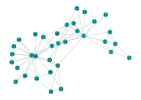

In [14]:
state_c = SIS(karat7,state_karat7,0,1,2) # Récupérer l'etat 
generate_graph(karat7, state_c)



4.  Test pour $\beta=0$ et $\alpha=0$ => On devrait avoir comme à l'état t=0 pour n'importe quelle valeur de t

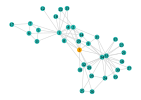

In [15]:
state_c = SIS(karat7,state_karat7,0,0,4) # Même à l'itération t=4 on obtient toujours comme pour t=0 
generate_graph(karat7, state_c)



1. Test pour une proba $\beta=1$, $\alpha=1$ => on sait que les voisins d'un infecté vont être automatiquement malade et à l'itération suivante les infectés de l'itération précédente guériront

Graphe initial à t=0

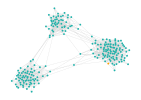

In [16]:
# Test on N7_2A
nbinf = 1
state_n7_2a = generate_infected(n7_2A,nbinf)
generate_graph(n7_2A, state_n7_2a)


Graphe à t=1

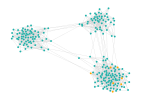

In [17]:
state_c = SIS(n7_2A,state_n7_2a,1,1,1) # Récupérer l'etat 
generate_graph(n7_2A, state_c)


2. Test pour $\beta=1$, $\alpha=0$ => Au bout d'un certain temps toutes les personnes devraient être inféctées

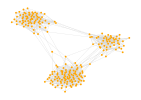

In [18]:
state_c = SIS(n7_2A,state_n7_2a,1,0,5) # Récupérer l'etat 
generate_graph(n7_2A, state_c)

3. Test pour $\beta=0$ et $\alpha=1$ => Au bout de la deuxieme itération (car on a qu'un seul infecté) on devrait voir que plus personne n'est malade

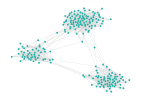

In [19]:
state_c = SIS(n7_2A,state_n7_2a,0,1,2) # Récupérer l'etat 
generate_graph(n7_2A, state_c)

4. Test pour $\beta=0$ et $\alpha=0$ => On devrait avoir comme à l'état t=0 pour n'importe quelle valeur de t

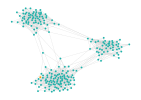

In [20]:
state_c = SIS(n7_2A,state_n7_2a,0,0,4) # Récupérer l'etat 
generate_graph(n7_2A, state_c)

1. Test pour une proba $\beta=1$, $\alpha=1$ => on sait que les voisins d'un infecté vont être automatiquement malade et à l'itération suivante les infectés de l'itération précédente guériront

Grpahe initial à t=0

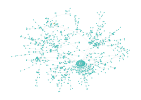

In [21]:
# Test on Toulouse_neigh
state_toulouse = generate_infected(toulouse_neigh,1)
generate_graph(toulouse_neigh, state_toulouse)

Graphe à t=1

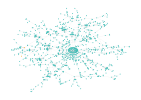

In [22]:
state_c = SIS(toulouse_neigh,state_toulouse,1,1,1) # Récupérer l'etat 
generate_graph(toulouse_neigh, state_c)

2. Test pour $\beta=1$, $\alpha=0$ => Au bout d'un certain temps toutes les personnes devraient être inféctées

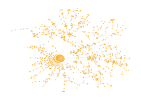

In [23]:
state_c = SIS(toulouse_neigh,state_toulouse,1,0,14) # Récupérer l'etat 
generate_graph(toulouse_neigh, state_c)

3. Test pour $\beta=0$ et $\alpha=1$ => Au bout de la deuxieme itération (car on a qu'un seul infecté) on devrait voir que plus personne n'est malade

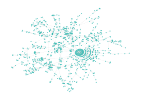

In [24]:
state_c = SIS(toulouse_neigh,state_toulouse,0,1,2) # Récupérer l'etat 
generate_graph(toulouse_neigh, state_c)

4.  Test pour $\beta=0$ et $\alpha=0$ => On devrait avoir comme à l'état t=0 pour n'importe quelle valeur de t

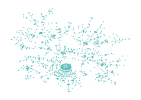

In [25]:
state_c = SIS(toulouse_neigh,state_toulouse,0,0,4) # Récupérer l'etat 
generate_graph(toulouse_neigh, state_c)

<div style="width:75%;margin:0 auto;">

### 1.4 Simulate and understand the epidemic
    
<p style="text-align:justify;">In the SIS model of this project, every disease is characterized by:
    
* The infection rate $\beta$ representing the chance of infection when being in contact with an infected individual.
* The curing rate $\alpha$ representing the chance of being cured of the disease.
* The effective spreading rate $\tau=\frac{\beta}{\alpha}$ representing the capacity of the disease to spread. 
The effective spreading rate $\tau$ increases with $\beta$ (easier infection) and decreases with $\alpha$ (easier recovery).

We are now willing to understand what are the influences of these parameters as well as the contact network shape on an epidemic.</p>

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 4 (written):</strong> The <code>function SIS</code> you implemented launches one run of an SIS model on a given contact network. As it makes use of randomness, one run of spreading is stochastic. Then what simple method can you propose to provide a prediction of the disease spreading on a given contact network ?
   
<br>
    
<div style="background-color:#E7F1D1"> <Strong>Answer:</Strong></div> 
    
    On peut introduire un paramètre nbsimu qui va correspondre au nombre de fois qu'on lance la simulation. On fait ensuite la moyenne des prédictions obtenue pour avoir une meilleure idée de la propagation de la maladie. Il s'agit d'une technique fréquemment utilisée notamment dans les réseaux de neurones : les batchs sont tirés de façon aléatoire et on réalise cette technique afin d'enlever le caractère stochastique.

<div style="width:75%;margin:0 auto;">
    
<strong style="color:cornflowerblue">Question 5 (code):</strong> Implement the <code>function Simulation_SIS</code> (respect the header and the specifications).
    
<span style="font-size:0.9em">The corrector should be able to write <code>predictions, taus = Simulation_SIS(net,nbinf,betas,alphas,t,nbsimu)</code> with your code.</span>

In [26]:
function Simulation_SIS(net,nbinf,betas,alphas,t,nbsimu)
    """Take a contact network, different diseases (defined by 
    different parameters alpha and beta), a number of initial
    infected people and process nbsimu simulations of SIS over
    t time steps. You will provide the prediction of the 
    percentage of infected at each time t as well as the 
    spreading rate of each disease.
    
    PARAMS
       net (LightGraph): graph representing the contact network
       nbinf (Int32): number of infected at the start of each 
            simulation
       betas (Array{Float64,1}): array of infection rate on edges
       alphas (Array{Float64,1}): array of curing rate on vertices
       t (Int32): number of time step
       nbsimu (Int32): number of simulations
    
    RETURNS
        (Array{Float64,2}): the prediction of the percentage of 
            infected at each time step and for each disease. The 
            first dimension contains the time steps and the second
            contains the diseases
        (Array{Float64,1}): effective spreading rate for each 
            disease
    """
    nb_maladies = length(betas)
    tau = betas./alphas #Calcul du taux de diffusion de la maladie
    prediction = zeros(t, nb_maladies)
    nb_noeuds = nv(net)
    state = zeros(Int32, nb_noeuds)
    for n in 1:nb_maladies
        for j in 1:nbsimu
            state = generate_infected(net,nbinf) #On génère un nouvel état pour chaque simulation
            for time in 1:t
                state=SIS(net,state,betas[n],alphas[n],1) #On récupère l'évolution de la maladie 
                prediction[time, n] += (sum(state)/(nv(net)))*100 #On ajoute la prédiction de pourcentage d'infecté 
            end
        end
    end
    prediction =prediction/nbsimu
    return prediction, tau
    
end

Simulation_SIS (generic function with 1 method)

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 6 (written)</strong>: Run the 2 scripts below and describe what you see. Conclude on the influence of $\tau$, $\beta$, and $\alpha$ on an epidemic we can model with SIS.
    
<br>
    
<div style="background-color:#E7F1D1"> <strong>Answer:</strong></div>
    On remarque que lorsque $\alpha < \beta$, $\tau$ devient plus grand et on obtient alors des pourcentages d'infectés beaucoup plus important. Ceci paraît logique car $\beta$ représente le pourcentage d'infectés donc si $\alpha < \beta$ la population devient plus inféctée que ne guérit.
    Et quand $\alpha > \beta$ nous avons l'inverse ($\tau$ est petit et le pourcentage d'infecté est plus faible) ce qui paraît cohérent car $\alpha$ représente le pourcentage de guérison donc quand $\alpha > \beta$ la population guérit plus rapidement qu'elle n'est infectée.

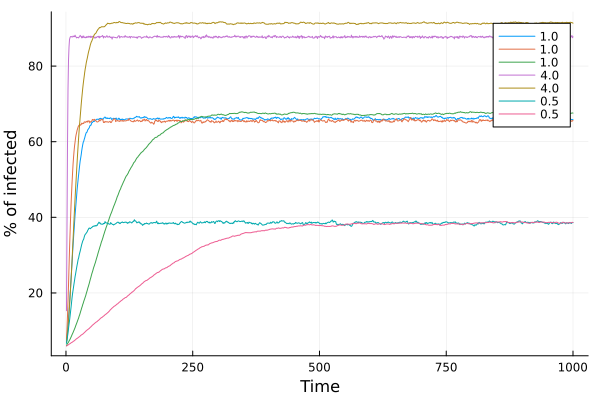

In [27]:
# Script launching predictions on different diseases on karat7 and printing 
# the precentage of infected at each time step.
betas=[0.05,0.1,0.01,0.4,0.04,0.05,0.005]
alphas=[0.05,0.1,0.01,0.1,0.01,0.1,0.01]
predictions, taus = Simulation_SIS(karat7,2,betas,alphas,1000,1000)
Plots.plot(predictions, label=taus',xlabel="Time",ylabel="% of infected")

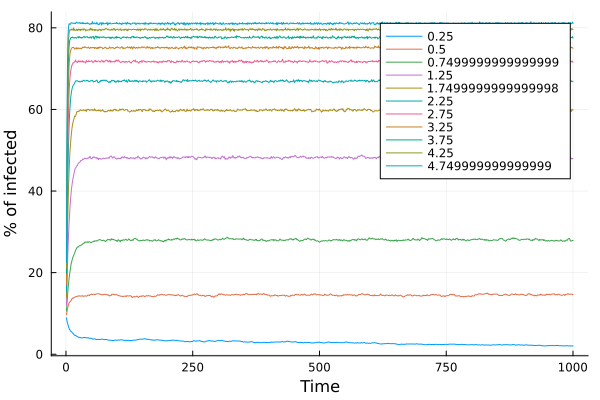

In [28]:
# Same as before but applied on toulouse_neigh. May be a bit long to run.
betas = [0.05,0.1,0.15,0.25,0.35,0.45,0.55,0.65,0.75,0.85,0.95]
alphas = [0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2]

predictions, taus = Simulation_SIS(toulouse_neigh,100,betas,alphas,1000,100)

Plots.plot(predictions, label=taus',xlabel="Time",ylabel="% of infected")

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 7 (written):</strong> Change the initial number of infected in the scripts above, is it in accordance with your answer in Question 2 ?
    
<br>
    
<div style="background-color:#E7F1D1"> <strong>Answer:</strong></div>
    En initialisant le nombre de personnes infectées (nbinf) à 5 on remarque que le pourcentage d'infectés est très inférieur à celui obtenu lorsque (nbinf=100). Cela signifie que la maladie se diffuse moins vite lorsque le nombre initial de personnes contaminées est faible et inversement. C'est ce que nous avions dit dans la question 2.

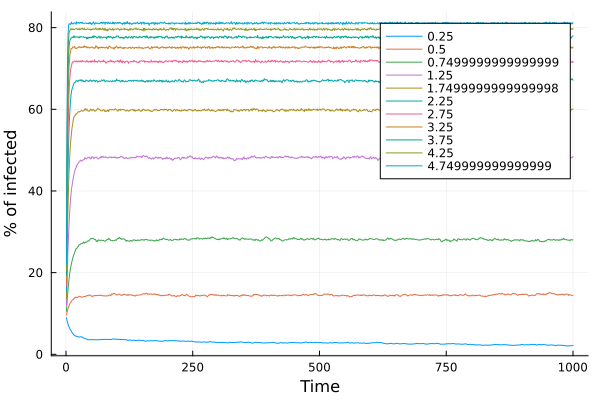

In [29]:
# Change the initial number of infected
betas = [0.05,0.1,0.15,0.25,0.35,0.45,0.55,0.65,0.75,0.85,0.95]
alphas = [0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2]

predictions, taus = Simulation_SIS(toulouse_neigh,100,betas,alphas,1000,100)

Plots.plot(predictions, label=taus',xlabel="Time",ylabel="% of infected")

<div style="width:75%;margin:0 auto;">

<strong style="color:cornflowerblue">Question 8 (code):</strong> Implement a script plotting the maximum percentage of infected people according to $\tau$ over 300 time steps for 3 contact networks:

* A regular graph of 200 vertices with degree 2.
* A regular graph of 200 vertices with degree 5.
* A regular graph of 200 vertices with degree 10.

You can use the function <code>random_regular_graph(n,d)</code> of LightGraphs. As you probably need to use a certain number of different values of $\tau$ to visualize something interesting (the more there are the more the figure will be smooth) you should fix $\alpha$ and make $\beta$ vary. 

<span style="font-size:0.9em">A regular graph is a graph where each vertex has the same degree.</span>

In [30]:
# Plots of the maximum percentage of infected people according to tau over 300 time 
# steps for 3 contact networks.
function max_percentage_inf(net,nbinf, betas, alphas, t)
    """maximum percentage of infected people according to tau over 300 time steps
    
    PARAMS
       net (LightGraph): graph representing the contact network
       betas (Array{Float64,1}): array of infection rate on edges
       alphas (Array{Float64,1}): array of curing rate on vertices
       n (Array{Float64,1}): number of vertices
       d (Array{Float64,1}): degree of the graph
       t (Int32): number of time step
       nbsimu (Int32): number of simulations
    
    RETURNS
        (Array{Float64,2}): the prediction of the percentage of 
            infected at each time step and for each disease. The 
            first dimension contains the time steps and the second
            contains the diseases
        (Array{Float64,1}): effective spreading rate for each 
            disease
    """

    predictions, taus = Simulation_SIS(net,nbinf,betas,alphas,300,1)
    max_percentage = zeros(length(taus))
    for i=1:length(taus)
        max_percentage[i] = maximum(predictions[:,i]) #On récupère la maximum du pourcentage pour chaque maladie 
    end
    return max_percentage, taus
end

max_percentage_inf (generic function with 1 method)

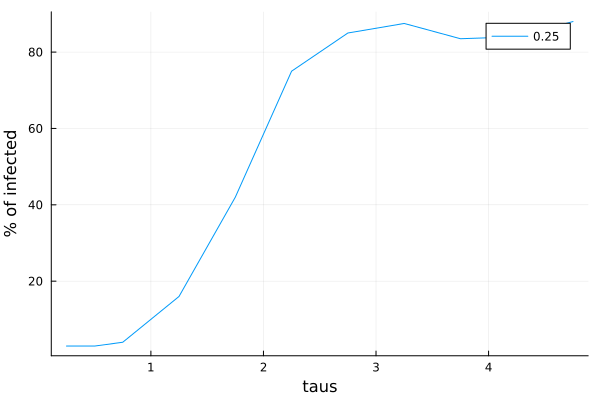

In [31]:
# Change the initial number of infected
nbinf= 5
betas = [0.05,0.1,0.15,0.25,0.35,0.45,0.55,0.65,0.75,0.85,0.95]
alphas = [0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2]
net = random_regular_graph(200,2)
max_percentage, taus= max_percentage_inf(net,nbinf, betas, alphas, 300)

Plots.plot(taus, max_percentage, label=taus',xlabel="taus",ylabel="% of infected")

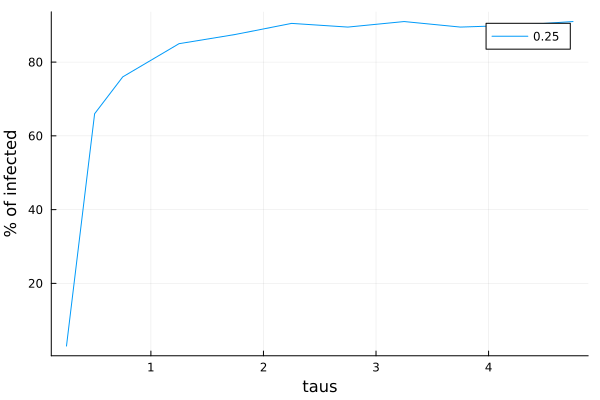

In [32]:
# Change the initial number of infected
nbinf= 5
betas = [0.05,0.1,0.15,0.25,0.35,0.45,0.55,0.65,0.75,0.85,0.95]
alphas = [0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2]
net = random_regular_graph(200,5)
max_percentage, taus= max_percentage_inf(net,nbinf, betas, alphas, 300)

Plots.plot(taus, max_percentage, label=taus',xlabel="taus",ylabel="% of infected")

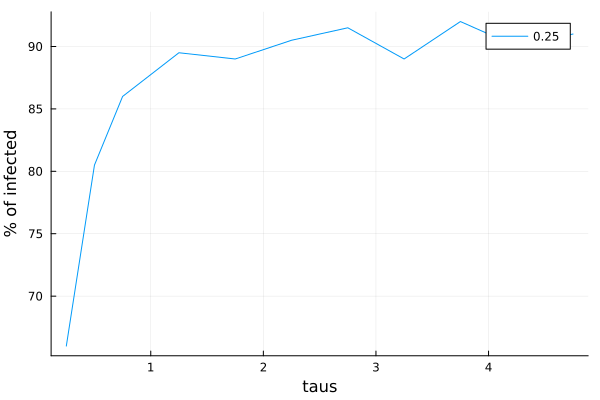

In [33]:
# Change the initial number of infected
nbinf= 5
betas = [0.05,0.1,0.15,0.25,0.35,0.45,0.55,0.65,0.75,0.85,0.95]
alphas = [0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2]
net = random_regular_graph(200,10)
max_percentage, taus= max_percentage_inf(net,nbinf, betas, alphas, 300)

Plots.plot(taus, max_percentage, label=taus',xlabel="taus",ylabel="% of infected")

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 9 (written):</strong> Describe the figure and draw conclusions on the epidemic behavior for different degrees $d$ on regular graphs. Thus, in addition to the inner properties of the disease ($\alpha$, $\beta$, $\tau$) what other parameter is essential in the spreading ? Finally, what analogy can be done with real life from this experiment ?
    
<br>
    
<div style="background-color:#E7F1D1"> <strong>Answer:</strong></div>
    On obtient une tendance assez similaire pour les trois graphiques. On plafonne a un pourcentage d'infecté autour de 85-90%. Cependant, on remarque que le pourcentage d'infecté lorsque t est proche de 0 est beaucoup plus faible lorsque le degré est petit. Ceci s'explique par le fait que lorsque une personne a peu de contact, la maladie va se propager plus lentement que si elle en avait beaucoup.
    Finalement, le pourcentage d'infecté augmente plus rapidement (jusqu'à atteindre un maximum) lorsque le degré est faible.

<div style="width:75%;margin:0 auto;">

## Part 2 - SIR and SAIR model
<a id='part2'></a>
    
<p style="text-align:justify;">Unfortunately SIS model is valuable for diseases we can catch back since a cured person can get ill again. This is true for the flu, the cold, etc. However COVID-19 might create immunity for whom already got it and SIS can not take into account immune or dead persons. That is why we propose in this part to consider another model more adapted to COVID-19 called SIR. It stands for Susceptible $\rightarrow$ Infected $\rightarrow$ Recovered where the susceptible group contains those who remain susceptible to the infection, the infected group consists of those who not only have the disease but are also in the contagious period of the disease, and the recovered group contains those who were ill, got cured, are not contagious and can not get ill anymore.</p>

<br>

<p style="font-size:0.9em">M. Youssef and C. Scoglio, <cite>"An individual-based approach to SIR epidemics in contact networks"</cite>, Journal of Theoretical Biology 283 (2011)</p>

<br>
    
<p style="text-align:justify;"> One limitation of SIR is that it does not model the reaction of humans when they feel the presence of the epidemic. Indeed, if feeling threaten or surrounded by infected, an individual may change its behaviors: wear mask, wash its hands, etc. This result in a smaller infection rate. That is why in this part we will also consider a variant of SIR called SAIR which stands for Susceptible $\rightarrow$ Alert $\rightarrow$ Infected $\rightarrow$ Recovered. A susceptible individual becomes infected by the infection rate $\beta_0$, an infected individual recovers and gets immune by the curing rate $\alpha$, an individual can observe the states of its neighbors, then a susceptible individual might go to the alert state if surrounded by infected individuals with an alert rate $\kappa$ on each contact with an infected, an alert inividual becomes infected by the infection rate $\beta_1$ where $0<\beta_1<\beta_0$. In our simple SAIR model, an individual can not go back to a susceptible state when he got into the alert state.</p>
    
<br>
    
<p style="font-size:0.9em"> F. Darabi Sahneh and C. Scoglio, <cite>"Epidemic Spread in Human Networks"</cite>, 50th IEEE Conf. Decision and Contol, Orlando, Florida (2011)</p>

<div style="width:75%;margin:0 auto;">

### 2.1 SIR
    
<p style="text-align:justify;">The vector containing the disease status <code>state</code> has to change a bit since we added a new state. Hence it will be an <code>Array{Int32,1}</code> where Susceptible=0, Infected=1, and Recovered=2.</p>

<div style="width:75%;margin:0 auto;">
    
<strong style="color:cornflowerblue">Question 10 (code):</strong> Implement the <code>function SIR</code> (respect the header and the specifications). You can use <code>rand</code> to translate the probabilities. Test your algorithm on <code>karat7</code>, <code>n7_2A</code>, and <code>toulouse_neigh</code> with arbitrary $\beta$, $\alpha$, and $t$. Recovered vertices should appear in a different color (<code>colorant"purple"</code>).
    
<span style="font-size:0.9em">The corrector should be able to write <code>new_state = SIR(net,state,beta,alpha,t)</code> with your code.</span>

In [34]:
function SIR(net,state,beta,alpha,t)
    """Take a contact network at a certain state and apply t time steps
    of an SIR model.
    
    PARAMS
       net (LightGraph): graph representing the contact network
       state (Array{Int32,1}): disease status of each vertex
       beta (Float64): infection rate
       alpha (Float64): curing rate
       t (Int32): number of time step
    
    RETURNS
        (Array{Int32,1}): The new state of the contact network after t time steps.
    """
    state_c = copy(state)#On crée une copie de state pour pouvoir modifier et retourner le vecteur avec les nouvelles infections
    for time_step in 1:t
        old_state = copy(state_c) #Copie de l'état précédent
        for s in 1:length(state_c)
            if old_state[s] ==1 # La personne est infectée 
                voisins = neighbors(net, s) #On récupère les voisins
                for n in 1:length(voisins) 
                    if old_state[voisins[n]]==0#La personne à l'itération précédente n'était pas infectée
                        if rand() <= beta 
                            state_c[voisins[n]]=1#Elle le devient avec la proba beta
                        end 
                    end 
                end 
                if rand() <= alpha 
                    state_c[s] = 2 #La personne est guérit avec la proba alpha
                    
                end
            end 
        end 
    end
    return state_c
end

SIR (generic function with 1 method)

1. Test pour une proba $\beta=1$, $\alpha=1$ => on sait que les voisins d'un infecté vont être automatiquement malade et à l'itération suivante les infectés de l'itération précédente guériront

Graphe initial à t=0

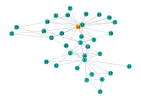

In [35]:
# Test on Karat7
nbinf=0
state_karat7 = generate_infected(karat7,1)
generate_graph(karat7, state_karat7)

Graphe à t=1

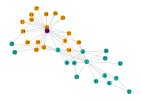

In [36]:
state_c = SIR(karat7,state_karat7,1,1,1)
generate_graph(karat7, state_c)

Graphe à t=2

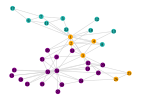

In [37]:
# Test on Karat7
state_c = SIR(karat7,state_karat7,1,1,2)
generate_graph(karat7, state_c)

2. Test pour $\beta=1$, $\alpha=0$ => Au bout d'un certain temps toutes les personnes devraient être inféctées

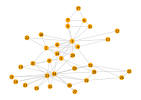

In [38]:
# Test on Karat7
state_c = SIR(karat7,state_karat7,1,0,6)
generate_graph(karat7, state_c)

3. Test pour $\beta=0$ et $\alpha=1$ => Au bout de la deuxieme itération (car on a qu'un seul infecté) on devrait voir qu'il n'y a personne de malade et la personne infectée est en violet.

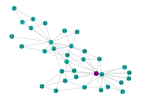

In [39]:
# Test on Karat7
state_c = SIR(karat7,state_karat7,0,1,2)
generate_graph(karat7, state_c)

4. Test pour $\beta=0$ et $\alpha=0$ => On devrait avoir comme à l'itération t=0

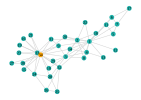

In [40]:
state_c = SIR(karat7,state_karat7,0,0,6)
generate_graph(karat7, state_c)

1. Test pour une proba $\beta=1$, $\alpha=1$ => on sait que les voisins d'un infecté vont être automatiquement malade et à l'itération suivante les infectés de l'itération précédente guériront

Graphe initial à t=0

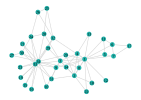

In [41]:
# Test on N7_2A
state_n7_2a = generate_infected(n7_2A,1)
generate_graph(karat7, state_n7_2a)

Graphe à t=1

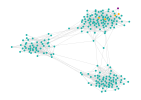

In [42]:
state_c = SIR(n7_2A,state_n7_2a,1,1,1)
generate_graph(n7_2A, state_c)

Graphe à t=2

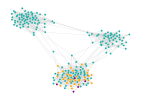

In [43]:
state_c = SIR(n7_2A,state_n7_2a,1,1,2)
generate_graph(n7_2A, state_c)

2. Test pour $\beta=1$, $\alpha=0$ => Au bout d'un certain temps toutes les personnes devraient être inféctées

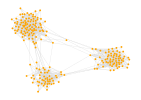

In [47]:
state_c = SIR(n7_2A,state_n7_2a,1,0,9)
generate_graph(n7_2A, state_c)

3. Test pour $\beta=0$ et $\alpha=1$ => Au bout de la deuxieme itération (car on a qu'un seul infecté) on devrait voir qu'il n'y a personne de malade et la personne infectée est en violet.

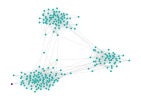

In [48]:
state_c = SIR(n7_2A,state_n7_2a,0,1,2)
generate_graph(n7_2A, state_c)

4. Test pour $\beta=0$ et $\alpha=0$ => Pareil que pour l'itération t=0

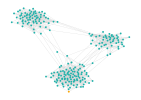

In [49]:
state_c = SIR(n7_2A,state_n7_2a,0,0,2)
generate_graph(n7_2A, state_c)

Graphe initial à t=0

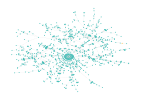

In [50]:
# Test on Toulouse_neigh
nb_inf=1
state_toulouse = generate_infected(toulouse_neigh,nb_inf)
generate_graph(toulouse_neigh, state_toulouse)

Graphe à t=1

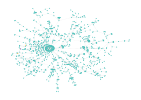

In [51]:
state_c = SIR(toulouse_neigh,state_toulouse,1,1,1)
generate_graph(toulouse_neigh, state_c)

Graphe à t=2

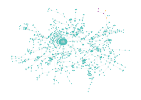

In [52]:
state_c = SIR(toulouse_neigh,state_toulouse,1,1,2)
generate_graph(toulouse_neigh, state_c)

2. Test pour $\beta=1$, $\alpha=0$ => Au bout d'un certain temps toutes les personnes devraient être inféctées

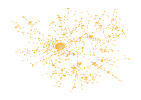

In [54]:
state_c = SIR(toulouse_neigh,state_toulouse,1,0,15)
generate_graph(toulouse_neigh, state_c)

3. Test pour $\beta=0$ et $\alpha=1$ => Au bout de la deuxieme itération (car on a qu'un seul infecté) on devrait voir qu'il n'y a personne de malade et la personne infectée est en violet.

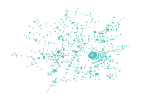

In [55]:
state_c = SIR(toulouse_neigh,state_toulouse,0,1,2)
generate_graph(toulouse_neigh, state_c)

4. Test pour $\beta=0$ et $\alpha=0$ => Pareil que pour t=0

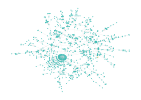

In [56]:
state_c = SIR(toulouse_neigh,state_toulouse,0,0,2)
generate_graph(toulouse_neigh, state_c)

<div style="width:75%;margin:0 auto;">
    
<strong style="color:cornflowerblue">Question 11 (code):</strong> Implement the <code>function Simulation_SIR</code> (respect the header and the specifications).
    
<span style="font-size:0.9em">The corrector should be able to write <code>predictions, taus = Simulation_SIR(net,nbinf,betas,alphas,t,nbsimu)</code> with your code.</span>

In [57]:
function Simulation_SIR(net,nbinf,betas,alphas,t,nbsimu)
    """Take a contact network, different diseases (defined by 
    different parameters alpha and beta), a number of initial
    infected people and process nbsimu simulations of SIR over
    t time steps. You will provide the prediction of the 
    percentage of infected at each time t as well as the 
    spreading rate of each disease.
    
    PARAMS
       net (LightGraph): graph representing the contact network
       nbinf (Int32): number of infected at the start of each 
            simulation
       betas (Array{Float64,1}): array of infection rate on edges
       alphas (Array{Float64,1}): array of curing rate on vertices
       t (Int32): number of time step
       nbsimu (Int32): number of simulations
    
    RETURNS
        (Array{Float64,3}): the prediction of the percentage of 
            infected, the percentage of susceptible and the 
            percentage of recovered at each time step and for each 
            disease. The first dimension contains the time steps,
            the second contains the diseases, and the third the status
            (Infected: [:,:,1], Recovered: [:,:,2], Susceptible: [:,:,3])
        (Array{Float64,1}): effective spreading rate for each 
            disease
    """
    nb_maladies = length(betas)
    tau = betas./alphas
    prediction = zeros(t, nb_maladies, 3)
    nb_noeuds = nv(net)
    state = zeros(Int32, nb_noeuds)
    for n in 1:nb_maladies
        for j in 1:nbsimu
            state = generate_infected(net,nbinf)
            for time in 1:t
                res=SIR(net,state,betas[n],alphas[n],1)
                state=res
                prediction[time, n,1] += (length(findall(x -> x==1.0, state))/(nv(net)))*100
                prediction[time, n,2] += (length(findall(x -> x==2.0, state))/(nv(net)))*100
                prediction[time, n,3] += (length(findall(x -> x==0.0, state))/(nv(net)))*100
            end
        end
    end
    prediction =prediction/nbsimu
    return prediction, tau
end

Simulation_SIR (generic function with 1 method)

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 12 (written):</strong> Run the script below and describe what you see. Why does the infected curve not behave the same as for SIS ? 
    
<br>

<div style="background-color:#E7F1D1"> <strong>Answer:</strong></div>
    On voit sur le graphique que lorsque t=0, nous avons beaucoup de personnes susceptibles d'être infectées, un certain nombre de personne infecté et personne n'a encore guérit. Ensuite, lorsque t=5 on remarque qu'on atteint un pic de personnes infectées.
    Finalement, plus le temps augmente plus le pourcentage de personnes guérit augmente jusqu'à attendire 100%. Le nombre de personnes susceptibles et de personnes infectées atteint lui 0%.
    Nous n'obtenons pas le même résultat que pour SIS car, cette fois-ci si une personne a été inféctée elle ne peut plus être inféctée de nouveau, ce qui n'était pas le cas avant.

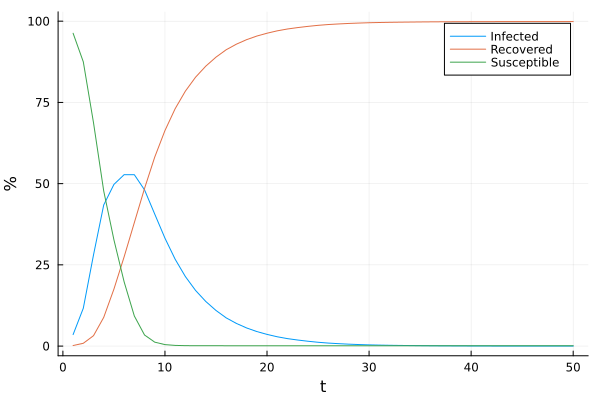

In [58]:
# Script launching prediction on one disease on n7_2A and plotting the percentage
# of infected, susceptible and recovered at each time step.
predictions, taus = Simulation_SIR(n7_2A,2,[0.3],[0.2],50,1000)

Plots.plot([predictions[:,:,1] predictions[:,:,2] predictions[:,:,3]],
           label=["Infected" "Recovered" "Susceptible"],xlabel="t",ylabel="%")

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 13 (written):</strong> As for Question 6 script 2 plot the evolution of the percentage of infected for many $\tau$. Describe what you see.
    
<br>
    
<div style="background-color:#E7F1D1"> <strong>Answer:</strong></div>
    Comme pour la question 6) nous voyons que si $\beta$ > $\alpha$ nous avons un pourcentage d'infecté qui est assez grand (ceci est cohérent car si $\beta$ > $\alpha$ la population est plus vite infectée qu'elle ne guérit). Cependant, quand $\alpha$ > $\beta$ le pourcentage d'infecté est faible (ceci est normal puisque si $\alpha$ > $\beta$ la population guérit plus vite qu'elle n'est infectée).
    Contrairement à la question 6) nous voyons que au bout d'un certain temps le pourcentage d'infecté tend vers 0

Karat7

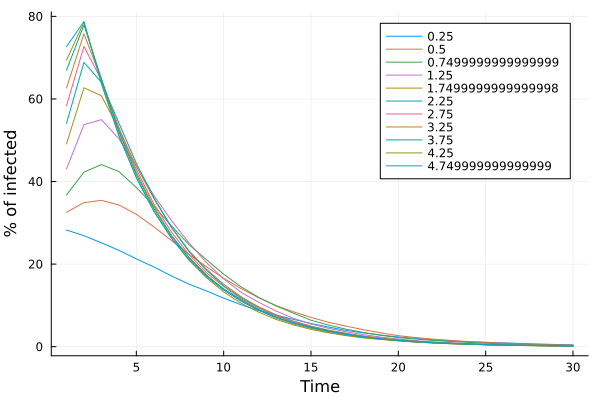

In [59]:
# Script launching predictions on different diseases on karat7 and printing 
# the precentage of infected at each time step.
betas = [0.05,0.1,0.15,0.25,0.35,0.45,0.55,0.65,0.75,0.85,0.95]
alphas = [0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2]
predictions, taus = Simulation_SIR(karat7,10,betas,alphas,30,1000)
Plots.plot(predictions[:,:,1], label=taus',xlabel="Time",ylabel="% of infected")

Toulouse neighbour

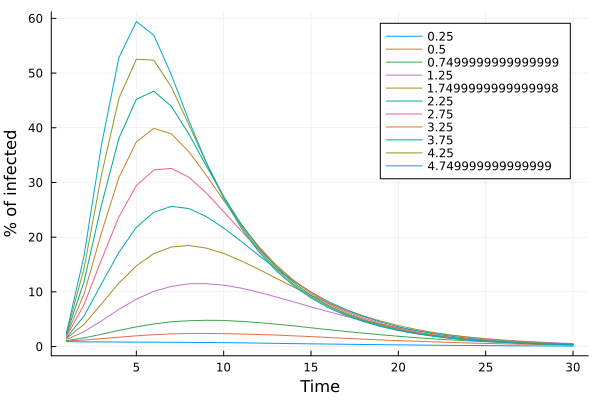

In [60]:
# Script launching predictions on different diseases on karat7 and printing 
# the precentage of infected at each time step.
betas = [0.05,0.1,0.15,0.25,0.35,0.45,0.55,0.65,0.75,0.85,0.95]
alphas = [0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2]
predictions, taus = Simulation_SIR(toulouse_neigh,10,betas,alphas,30,1000)
Plots.plot(predictions[:,:,1], label=taus',xlabel="Time",ylabel="% of infected")

N7_2A

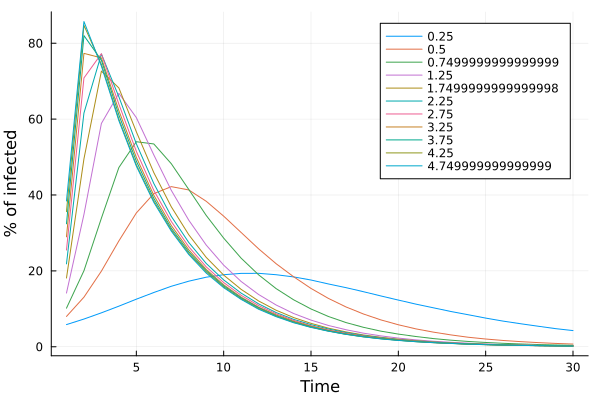

In [61]:
# Script launching predictions on different diseases on karat7 and printing 
# the precentage of infected at each time step.
betas = [0.05,0.1,0.15,0.25,0.35,0.45,0.55,0.65,0.75,0.85,0.95]
alphas = [0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2,0.2]
predictions, taus = Simulation_SIR(n7_2A,10,betas,alphas,30,1000)
Plots.plot(predictions[:,:,1], label=taus',xlabel="Time",ylabel="% of infected")

<div style="width:75%;margin:0 auto;">

<strong style="color:cornflowerblue">Question 14 (code):</strong> Implement a script plotting the number of infected over 75 time steps for $\beta=0.3$ and $\alpha=0.2$ fixed and on 3 contact networks:
    
* A regular graph of 200 vertices with degree 2.
* A regular graph of 200 vertices with degree 5.
* A regular graph of 200 vertices with degree 10.
    

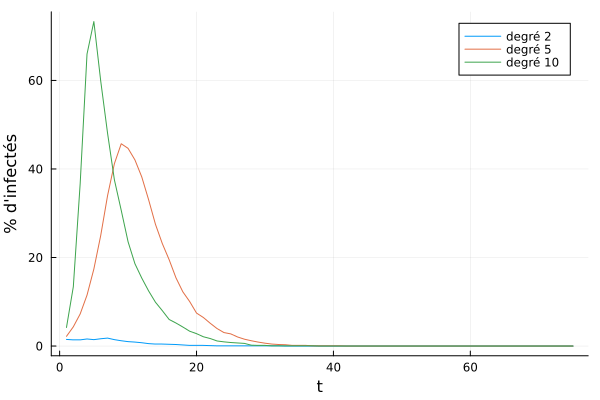

In [62]:
# Plots of the number of infected people according to tau over 75 time 
# steps for 3 contact networks.
net = random_regular_graph(200,2)
predictions, taus = Simulation_SIR(net,2,[0.3],[0.2],75,10)

net2 = random_regular_graph(200,5)
predictions2, taus2 = Simulation_SIR(net2,2,[0.3],[0.2],75,10)

net3 = random_regular_graph(200,10)
predictions3, taus3 = Simulation_SIR(net3,2,[0.3],[0.2],75,10)


Plots.plot(predictions[:,1,1],
           label="degré 2",xlabel="t",ylabel="% d'infectés")
Plots.plot!(predictions2[:,1,1],
           label="degré 5",xlabel="t",ylabel="% d'infectés")
Plots.plot!(predictions3[:,1,1],
           label="degré 10",xlabel="t",ylabel="% d'infectés")

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 15 (written):</strong> From the previous figure, explain why lockdown can be interesting when hospital places are lacking ?

<br>
    
<div style="background-color:#E7F1D1"> <strong>Answer:</strong></div>
    
    On remarque que lorsque le nombre de degrés est faible (= une personne a peu de contact) le pourcentage d'infectés est plus proche de 0. Au contraire, plus le nombre de degrés augmente (= plus la personne a de contact) plus le pourcentage d'infectés augmente. Cela signifie que si une personne réduit son nombre de contact elle sera moins susceptible d'être malade d'où l'utilité d'un confinement pour réduire le nombre de contacts des personnes.

<div style="width:75%;margin:0 auto;">

### 2.2 SAIR
    
<p style="text-align:justify;">The vector containing the disease status <code>state</code> has to change a bit since we added a new state. Hence it will be an <code>Array{Int32,1}</code> where Susceptible=0, Infected=1, Recovered=2, and Alert=3.</p>

<div style="width:75%;margin:0 auto;">
    
<strong style="color:cornflowerblue">Question 16 (code):</strong> Implement the <code>function SAIR</code> (respect the header and the specifications). You can use <code>rand</code> to translate the probabilities. Test your algorithm on <code>karat7</code>, <code>n7_2A</code>, and <code>toulouse_neigh</code> with arbitrary $\beta$, $\alpha$, and $t$. Alerted vertices should appear in a different color (<code>colorant"lightgreen"</code>).
    
<span style="font-size:0.9em">The corrector should be able to write <code>new_state = SAIR(net,state,beta0,beta1,alpha,kappa,t)</code> with your code.</span>

In [63]:
function SAIR(net,state,beta0,beta1,alpha,kappa,t)
    """Take a contact network at a certain state and apply t time steps
    of an SAIR model.
    
    PARAMS
       net (LightGraph): graph representing the contact network
       state (Array{Int32,1}): disease status of each vertex
       beta0 (Float64): infection rate when not alert
       beta1 (Float64): infection rate when alert
       alpha (Float64): curing rate
       kappa (Float64): alerting rate
       t (Int32): number of time step
    
    RETURNS
        (Array{Int32,1}): The new state of the contact network after t time steps.
    """      
    state_c = copy(state)#On crée une copie de state pour pouvoir modifier et retourner le vecteur avec les nouvelles infections
    for time_step in 1:t
        old_state = copy(state_c)
        for s in 1:length(state_c) 
            #On passe de infecté à guérit avec la proba alpha et on contamine ses voisins avec la proba beta0
            if old_state[s] ==1 # La personne est infectée 
                voisins = neighbors(net, s) #On récupère les voisins de la s ième personne
                for n in 1:length(voisins) #On parcourt les voisins 
                    if old_state[voisins[n]]==0 && rand()< beta0 #Personne susceptible devient infectée avec porba beta0
                        state_c[voisins[n]]=1
                    elseif old_state[voisins[n]]==3 && rand()<beta1 #Personne alerte devient infectée avec proba beta1
                        state_c[voisins[n]]=1
                    elseif old_state[voisins[n]]==0 && rand()<kappa #Personne susceptible devient alerte avec proba kappa
                        state_c[voisins[n]]=3
                    end
                    
                end 
                if rand() <= alpha #Personne guérit avec proba alpha
                    state_c[s] = 2
                end
            end 
            end 
    end
    return state_c
end

SAIR (generic function with 1 method)

1. Test pour une proba $\beta=1$, $\alpha=1$ => on sait que les voisins d'un infecté vont être automatiquement malade et à l'itération suivante les infectés de l'itération précédente guériront

Etat t=0

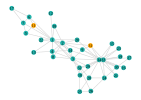

In [64]:
# Test on Karat7
nbinf=2
state_karat7 = generate_infected(karat7,nbinf)
generate_graph(karat7, state_karat7)


A l'état t=1

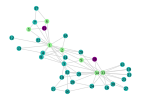

In [65]:
state_c = SAIR(karat7,state_karat7,0,1,1,1,1)
generate_graph(karat7, state_c)

$\beta_0$ = 0. Donc les infectés ne contaminent pas les susceptibles. Ils contaminent donc seulement ceux qui sont en alerte. Cela explique la non présence d'individu colorié en orange à partir de t = 1.

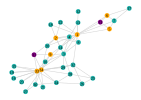

In [66]:
state_c = SAIR(karat7,state_karat7,1,0.99999,1,1,1)
generate_graph(karat7, state_c)


$\beta_0$ = 1. Donc les infectés contaminent forcément les susceptibles et donc les individus n'ont pas le temps d'être alertés.

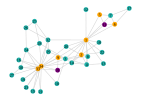

In [67]:
state_c = SAIR(karat7,state_karat7,1,0.9999,1,0,1)
generate_graph(karat7, state_c)

kappa = 0, on retrouve la modélisation SIR.

A l'état t = 0

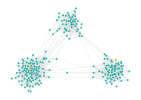

In [68]:
# Test on N7_2A
nbinf=2
state_n7_2A= generate_infected(n7_2A,nbinf)
generate_graph(n7_2A, state_n7_2A)


A l'état t=1

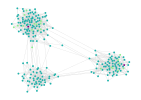

In [69]:
state_c = SAIR(n7_2A,state_n7_2A,0,1,1,1,1)
generate_graph(n7_2A, state_c)

$\beta_0$ = 0. Donc les infectés ne contaminent pas les susceptibles. Ils contaminent donc seulement ceux qui sont en alerte. Cela explique la non présence d'individu colorié en orange.

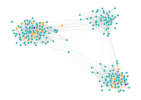

In [70]:
state_c = SAIR(n7_2A,state_n7_2A,1,1,1,1,1)
generate_graph(n7_2A, state_c)


$\beta_0$ = 1. Donc les infectés contaminent forcément les susceptibles et donc les individus n'ont pas le temps d'être alertés.

A t = 0

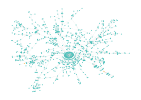

In [71]:
# Test on Toulouse_neigh
nbinf=2
state_toulouse = generate_infected(toulouse_neigh,nbinf)
generate_graph(toulouse_neigh, state_toulouse)

A l'état t=1

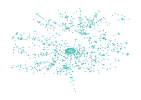

In [72]:
state_c = SAIR(toulouse_neigh,state_toulouse,0,1,1,1,1)
generate_graph(toulouse_neigh, state_c)


$\beta_0$ = 0. Donc les infectés ne contaminent pas les susceptibles. Ils contaminent donc seulement ceux qui sont en alerte. Cela explique la non présence d'individu colorié en orange.

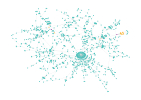

In [73]:
state_c = SAIR(toulouse_neigh,state_toulouse,1,1,1,1,1)
generate_graph(toulouse_neigh, state_c)

$\beta_0$ = 1. Donc les infectés contaminent forcément les susceptibles et donc les individus n'ont pas le temps d'être alertés.

<div style="width:75%;margin:0 auto;">
    
<strong style="color:cornflowerblue">Question 17 (code):</strong> Implement the <code>function Simulation_SAIR</code> (respect the header and the specifications).
    
<span style="font-size:0.9em">The corrector should be able to write <code>predictions, taus = Simulation_SAIR(net,nbinf,betas0,betas1,alphas,kappas,t,nbsimu)</code> with your code.</span>

In [74]:
function Simulation_SAIR(net,nbinf,betas0,betas1,alphas,kappas,t,nbsimu)
    """Take a contact network, different diseases (defined by 
    different parameters alpha and beta), a number of initial
    infected people and process nbsimu simulations of SAIR over
    t time steps. You will provide the prediction of the 
    percentage of infected at each time t as well as the 
    spreading rate of each disease.
    
    PARAMS
       net (LightGraph): graph representing the contact network
       nbinf (Int32): number of infected at the start of each 
            simulation
       betas0 (Array{Float64,1}): array of infection rate when not alert on edges
       betas1 (Array{Float64,1}): array of infection rate when alert on edges
       alphas (Array{Float64,1}): array of curing rate on vertices
       kappas (Array{Float64,1}): array of alerting rate on edges
       t (Int32): number of time step
       nbsimu (Int32): number of simulations
    
    RETURNS
        (Array{Float64,3}): the prediction of the percentage of 
            infected, the percentage of susceptible and the 
            percentage of recovered at each time step and for each 
            disease. The first dimension contains the time steps,
            the second contains the diseases, and the third the status
            (Infected: [:,:,1], Recovered: [:,:,2], Susceptible: [:,:,3])
        (Array{Float64,1}): effective spreading rate for each 
            disease
    """
    
    nb_maladies = length(betas0)
    tau = betas0./alphas
    prediction = zeros(t, nb_maladies, 3)
    nb_noeuds = nv(net)
    state = zeros(Int32, nb_noeuds)
    for n in 1:nb_maladies
        for j in 1:nbsimu
            state = generate_infected(net,nbinf)
            for time in 1:t
                res = SAIR(net,state,betas0[n],betas1[n],alphas[n],kappas[n],1)
                state=res
                prediction[time, n,1] += (length(findall(x -> x==1.0, state))/(nv(net)))*100
                prediction[time, n,2] += (length(findall(x -> x==2.0, state))/(nv(net)))*100
                prediction[time, n,3] += (length(findall(x -> x==0.0, state))/(nv(net)))*100
            end
        end
    end
    prediction =prediction/nbsimu
    return prediction, tau
    
end

Simulation_SAIR (generic function with 1 method)

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 18 (written):</strong> Run the script below comparing the number of infected of SAIR and SIR and comment what you see.
    
<br>
    
<div style="background-color:#E7F1D1"> <strong>Answer:</strong></div>
    La forme de la courbe reste la même dans les deux cas. Cependant, le pic du pourcentage d'infecté est beaucoup moins important pour la méthode SAIR que la méthode SIR. Ceci peut être expliqué par le fait que une personne au stade alerté va sûrement se protéger et s'isoler pour ne pas être infecté.

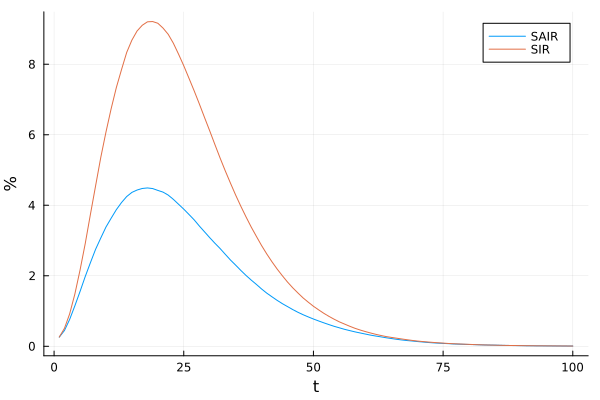

In [75]:
# Script launching prediction on one disease on toulouse_neigh and plotting the percentage
# of infected at each time step for SIR and SAIR.
predictions1, taus1 = Simulation_SAIR(toulouse_neigh,2,[0.2],[0.1],[0.1],[0.4],100,1000)
predictions2, taus2 = Simulation_SIR(toulouse_neigh,2,[0.2],[0.1],100,1000)

Plots.plot([predictions1[:,:,1] predictions2[:,:,1]],
           label=["SAIR" "SIR"],xlabel="t",ylabel="%")

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 19 (written):</strong> Of course the presented SIS, SIR, and SAIR models are limitated in their modelization of the reality. Formulate few of these limitations (at least 2). 
Propose few algorithm addons/ideas (at least 2) which would make the models more complex and more accurate in regards to the reality.
    
<br>
    
<div style="background-color:#E7F1D1"> <strong>Answer:</strong></div>
    
    - Quand on prend le cas du covid, une personne qui a déjà été inféctée peut-être re inféctée un certain temps après. Il faudrait alors prendre en compte le fait que quand state[n]=2 on peut repasser au stade state[n]=1.  

    - L'utilisation de médicaments/vaccins/outils médicaux pourraint aussi impacter l'évolution de la maladie et réduire le pourcentage d'infecté.
    
    - Il faudrait prendre en compte le fait que une personne alerté peut redevenir susceptible au bout d'un certain temps.

<div style="width:75%;margin:0 auto;">

## Part 3 - Discover patient zero
    
<p style="text-align:justify;"> In the two previous parts you may have realised that understanding and controlling the spread of epidemics on contact networks is an important task. However, information about
the origin of the epidemic could be also extremely useful to reduce or prevent future outbreaks. Thus, in this part we will focus on algorithm solutions to answer this issue.</p>
    
<p style="text-align:justify;"> The stochastic nature of infection propagation makes the estimation of the epidemic origin intrinsically hard: indeed, different initial conditions can lead to the same configuration at the observation time. Methods such as the distance centrality or the Jordan center try to approximate it. They both rely on spatial information by stating that the first infected is probably at the center of the cluster of infection. Mathematically:
    
* The jordan center is expressed as $\min_{v\in \mathcal{I}}\max_{n\in \mathcal{I}}d(v,n)$ where $\mathcal{I}$ is a connected component of the original contact network containing all infected and recovered vertices, and where $d(\cdot,\cdot)$ is the distance (= the shortest path) between 2 vertices (if not weighted graph each edge accounts for 1 unit). 
* The distance centrality is expressed as $\min_{v\in \mathcal{I}}\sum_{n\in \mathcal{I}}d(v,n)(\delta_{n,I} + \delta_{n,R}/\alpha)$, where $\delta_{n,I}=1$ if the vertex n is infected ($=0$ otherwise), and where $\delta_{n,R}=1$ if the vertex n is recovered ($=0$ otherwise). You may note that in distance centrality we increase the weight of the recovered vertices by a factor $1/\alpha$, it translates the fact that recovered vertices tend to be closer to the origin of the epidemic since they probably got ill before.
    
    
We formulate the problem as follow: given a contact network and a snapshot of epidemic spread at a certain time, determine the infection source. A snapshot is a given <code>state</code> array for a contact network.</p>

<br>
    
<p style="font-size:0.9em"> A. Y. Lokhov, M. Mézard, H. Ohta, and L. Zdeborová, <cite>"Inferring the origin of an epidemic with a dynamic message-passing algorithm"</cite>, Physical Review (2014)</p>

<div style="width:75%;margin:0 auto;">
    
<strong style="color:cornflowerblue">Question 20 (code):</strong> Implement the <code>function jordan</code> (respect the header and the specifications). You will need to use the function <code>dijkstra_shortest_paths</code> of the LighGraphs library, refer to the doc for more information. If there are multiple minimal vertices, then return the first one.
    
<span style="font-size:0.9em">The corrector should be able to write <code>zero = jordan(g,state,alpha)</code> with your code.</span>

In [75]:
function jordan(g,state)
    """Find patient zero by mean of the jordan center method.
    
    PARAMS
        g (LightGraph): graph representing the contact network
        state (Array{Int32,1}): disease status of each vertex
    
    RETURNS
        (Int32): the patient zero vertex number 
    """
    nb_sommets = nv(g)
    maximum_ = zeros(nb_sommets)
    for n= 1:nb_sommets
        if state[n]==1 || state[n]==2
            maximum_[n] = maximum(dijkstra_shortest_paths(g, n).dists)
        else
            maximum_[n] = Inf
        end
    
    end
    return argmin(maximum_)
    
end

jordan (generic function with 1 method)

<div style="width:75%;margin:0 auto;">
    
<strong style="color:cornflowerblue">Question 21 (code):</strong> Implement the <code>function distance</code> (respect the header and the specifications). You will need to use the function <code>dijkstra_shortest_paths</code> of the LighGraphs library, refer to the doc for more information. If there are multiple minimal vertices, then return the first one.
    
<span style="font-size:0.9em">The corrector should be able to write <code>zero = distance(g,state,alpha)</code> with your code.</span>

In [76]:
function distance(g,state,alpha=1.)
    """Find patient zero by mean of the distance centrality method.
    
    PARAMS
        g (LightGraph): graph representing the contact network
        state (Array{Int32,1}): disease status of each vertex
        alpha (Float64): curing rate
    
    RETURNS
        (Int32): the patient zero vertex number 
    """
    nb_sommets = nv(g)
    dist_somme = zeros(nb_sommets)
    for n= 1:nb_sommets
        if state[n]==1
            dist_somme[n] = sum(dijkstra_shortest_paths(g, n).dists)
        elseif state[n]==2
            dist_somme[n] = sum(dijkstra_shortest_paths(g, n).dists ./alpha)
        else    
            dist_somme[n] = Inf
        end
    
    end
    return argmin(dist_somme)
end

distance (generic function with 2 methods)

<div style="width:75%;margin:0 auto;">

<strong style="color:cadetblue">Question 22 (written):</strong> Run the 3 following scripts using your functions <code>jordan</code> and <code>distance</code> and comment on the results.
    
The contact network is karat7 for 2 different patient zero and a $50\times 50$ grid. The real patient zero ("Z"), your jordan ("J") and distance ("D") approximations are appearing in <code>colorant"lightblue"</code>.
    
<br>
    
<div style="background-color:#E7F1D1"> <strong> Answer:</strong></div>
    On remarque que pour le premier patient zéro les deux méthodes retrouvent bien le bon patient zéro.
    Pour le deuxième patient zéro, bien que les deux méthodes trouvent le même patient, il ne correspond pas au patient zéro (les deux méthodes donnent un patient qui est très proche du patient zéro mais nous n'avons pas exactement le même). On peut expliquer cela par le fait que ces deux méthodes sont basées sur le centre de gravité, donc elles ne vont pas forcément trouver la personne exacte mais des personnes qui sont proche de celui-ci.

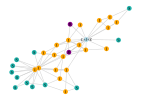

In [77]:
# Loading a snapshot of karat7
@load "karat7_Q22_1.jld2" g state pat_zero alpha beta loc_x loc_y

# Run the patient zero finding function
cent_pat_zero = distance(g,state,alpha)
jor_pat_zero = jordan(g,state)

# Some display options 
labels = Array{String, 1}(undef,nv(g))
for k=1:nv(g)
    if state[k]==1
        labels[k]="I"
    elseif state[k]==2
        labels[k]="R"
    else
        labels[k]="S"
    end
end

if cent_pat_zero==jor_pat_zero==pat_zero
    labels[cent_pat_zero]="C+J+Z"
elseif cent_pat_zero==jor_pat_zero
    labels[cent_pat_zero]="C+J"
    labels[pat_zero]="Z"
elseif cent_pat_zero==pat_zero
    labels[cent_pat_zero]="C+Z"
    labels[jor_pat_zero]="J"
elseif jor_pat_zero==pat_zero
    labels[jor_pat_zero]="J+Z"
    labels[cent_pat_zero]="C"
else
    labels[cent_pat_zero]="C"
    labels[jor_pat_zero]="J"
    labels[pat_zero]="Z"
end

nodecolor = [colorant"lightseagreen", colorant"orange", colorant"purple"]
colors = nodecolor[state + ones(Int32,nv(g))]
colors[pat_zero] = colorant"lightblue"
colors[cent_pat_zero] = colorant"lightblue"
colors[jor_pat_zero] = colorant"lightblue"

# Display
gplot(g,loc_x,loc_y,nodefillc=colors,nodelabel=labels)

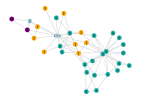

In [78]:
# Loading a snapshot of karat7
@load "karat7_Q22_2.jld2" g state pat_zero alpha beta loc_x loc_y

# Run the patient zero finding function
cent_pat_zero = distance(g,state,alpha)
jor_pat_zero = jordan(g,state)

# Some display options 
labels = Array{String, 1}(undef,nv(g))
for k=1:nv(g)
    if state[k]==1
        labels[k]="I"
    elseif state[k]==2
        labels[k]="R"
    else
        labels[k]="S"
    end
end

if cent_pat_zero==jor_pat_zero==pat_zero
    labels[cent_pat_zero]="C+J+Z"
elseif cent_pat_zero==jor_pat_zero
    labels[cent_pat_zero]="C+J"
    labels[pat_zero]="Z"
elseif cent_pat_zero==pat_zero
    labels[cent_pat_zero]="C+Z"
    labels[jor_pat_zero]="J"
elseif jor_pat_zero==pat_zero
    labels[jor_pat_zero]="J+Z"
    labels[cent_pat_zero]="C"
else
    labels[cent_pat_zero]="C"
    labels[jor_pat_zero]="J"
    labels[pat_zero]="Z"
end

nodecolor = [colorant"lightseagreen", colorant"orange", colorant"purple"]
colors = nodecolor[state + ones(Int32,nv(g))]
colors[pat_zero] = colorant"lightblue"
colors[cent_pat_zero] = colorant"lightblue"
colors[jor_pat_zero] = colorant"lightblue"

# Display
gplot(g,loc_x,loc_y,nodefillc=colors,nodelabel=labels)

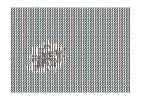

In [79]:
# Loading a snapshot of grid50
@load "grid50_Q22.jld2" g state pat_zero alpha beta loc_x loc_y

# Run the patient zero finding function
cent_pat_zero = distance(g,state,alpha)
jor_pat_zero = jordan(g,state)

# Some display options 
labels = Array{String, 1}(undef,nv(g))
for k=1:nv(g)
    if state[k]==1
        labels[k]="I"
    elseif state[k]==2
        labels[k]="R"
    else
        labels[k]="S"
    end
end

if cent_pat_zero==jor_pat_zero==pat_zero
    labels[cent_pat_zero]="C+J+Z"
elseif cent_pat_zero==jor_pat_zero
    labels[cent_pat_zero]="C+J"
    labels[pat_zero]="Z"
elseif cent_pat_zero==pat_zero
    labels[cent_pat_zero]="C+Z"
    labels[jor_pat_zero]="J"
elseif jor_pat_zero==pat_zero
    labels[jor_pat_zero]="J+Z"
    labels[cent_pat_zero]="C"
else
    labels[cent_pat_zero]="C"
    labels[jor_pat_zero]="J"
    labels[pat_zero]="Z"
end

nodecolor = [colorant"lightseagreen", colorant"orange", colorant"purple"]
colors = nodecolor[state + ones(Int32,nv(g))]
colors[pat_zero] = colorant"lightblue"
colors[cent_pat_zero] = colorant"lightblue"
colors[jor_pat_zero] = colorant"lightblue"

# Display
gplot(g,loc_x,loc_y,nodefillc=colors,nodelabel=labels)